## Compression of a coloured picture (RGB-Picture)

In [30]:
import numpy as np
import pandas as pd
import os
from PIL import Image
import pywt
import matplotlib.pyplot as plt
%matplotlib inline

In [31]:
data_forest = np.asarray(Image.open('wald.jpg'))
shape = data_forest.shape
number_of_pixels = shape[0]*shape[1]
number_of_values = shape[0]*shape[1]*shape[2] #will be used for compression rate later

In [77]:
data_forest

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [239, 239, 239],
        [228, 228, 228],
        [235, 235, 235]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [240, 240, 240],
        [235, 235, 235],
        [242, 242, 242]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [235, 235, 235],
        [237, 237, 237],
        [241, 241, 241]],

       ...,

       [[123, 153, 117],
        [100, 130,  96],
        [ 74, 101,  70],
        ...,
        [190, 183, 165],
        [ 90,  84,  70],
        [ 69,  65,  53]],

       [[121, 151, 113],
        [102, 132,  96],
        [ 69,  96,  63],
        ...,
        [235, 226, 209],
        [145, 137, 124],
        [ 98,  92,  78]],

       [[ 93, 124,  83],
        [ 77, 107,  69],
        [ 37,  64,  29],
        ...,
        [240, 231, 214],
        [191, 184, 168],
        [133, 127, 113]]

In [32]:
r = data_forest[:,:,0]
g = data_forest[:,:,1]
b = data_forest[:,:,2]

In [33]:
coeff_r = pywt.dwt2(r, 'bior1.3')
coeff_g = pywt.dwt2(g, 'bior1.3')
coeff_b = pywt.dwt2(b, 'bior1.3')

In [34]:
LL_r, (LH_r, HL_r, HH_r) = coeff_r
LL_g, (LH_g, HL_g, HH_g) = coeff_g
LL_b, (LH_b, HL_b, HH_b) = coeff_b

#print(LH_r.shape)
#print(HL_r.shape)
#print(HH_r.shape)
#print(LL_r.shape)

In [35]:
nz_ll_r = np.count_nonzero(LL_r)
nz_lh_r = np.count_nonzero(LH_r)
nz_hl_r = np.count_nonzero(HL_r)
nz_hh_r = np.count_nonzero(HH_r)

In [36]:
LL_r_del = pywt.threshold(LL_r, 0.001, mode='greater', substitute=0)
nz_ll_r_del = np.count_nonzero(LL_r_del)

LH_r_del = pywt.threshold(LH_r, 0.001, mode='greater', substitute=0)
nz_lh_r_del = np.count_nonzero(LH_r_del) 

HL_r_del = pywt.threshold(HL_r, 0.001, mode='greater', substitute=0)
nz_hl_r_del = np.count_nonzero(HL_r_del)  

HH_r_del = pywt.threshold(HH_r, 0.001, mode='greater', substitute=0)
nz_hh_r_del = np.count_nonzero(HH_r_del) 



LL_g_del = pywt.threshold(LL_g, 0.001, mode='greater', substitute=0)
nz_ll_g_del = np.count_nonzero(LL_g_del)

LH_g_del = pywt.threshold(LH_g, 0.001, mode='greater', substitute=0)
nz_lh_g_del = np.count_nonzero(LH_g_del) 

HL_g_del = pywt.threshold(HL_g, 0.001, mode='greater', substitute=0)
nz_hl_g_del = np.count_nonzero(HL_g_del)  

HH_g_del = pywt.threshold(HH_g, 0.001, mode='greater', substitute=0)
nz_hh_g_del = np.count_nonzero(HH_g_del) 



LL_b_del = pywt.threshold(LL_b, 0.001, mode='greater', substitute=0)
nz_ll_b_del = np.count_nonzero(LL_b_del)

LH_b_del = pywt.threshold(LH_b, 0.001, mode='greater', substitute=0)
nz_lh_b_del = np.count_nonzero(LH_b_del) 

HL_b_del = pywt.threshold(HL_b, 0.001, mode='greater', substitute=0)
nz_hl_b_del = np.count_nonzero(HL_b_del)  

HH_b_del = pywt.threshold(HH_b, 0.001, mode='greater', substitute=0)
nz_hh_b_del = np.count_nonzero(HH_b_del) 

In [37]:
r_inv=pywt.idwt2((LL_r_del,(LH_r_del,HL_r_del,HH_r_del)), 'bior1.3')
g_inv=pywt.idwt2((LL_g_del,(LH_g_del,HL_g_del,HH_g_del)), 'bior1.3')
b_inv=pywt.idwt2((LL_b_del,(LH_b_del,HL_b_del,HH_b_del)), 'bior1.3')

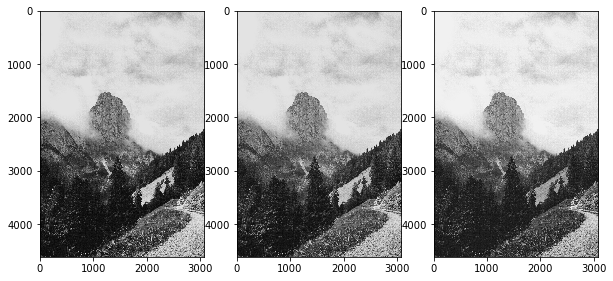

In [39]:
fig = plt.figure(figsize=(10,30))

plt.subplot(1, 3, 1)
plt.imshow(r_inv,interpolation='nearest',cmap=plt.cm.gray);

plt.subplot(1, 3, 2)
plt.imshow(g_inv,interpolation='nearest',cmap=plt.cm.gray);

plt.subplot(1, 3, 3)
plt.imshow(b_inv,interpolation='nearest',cmap=plt.cm.gray);

#plt.show() I don't need this, bcs I used inline when importing matplotlib
#TODO Headline for each picture

In [25]:
#No Idea, why this would only show the 3rd one.
#fix, ax = plt.subplots(1, 3, figsize=(10,10))
#plt.imshow(r_inv,interpolation='nearest',cmap=plt.cm.gray)#, ax=ax);
#plt.imshow(g_inv,interpolation='nearest',cmap=plt.cm.gray)#, ax=ax);
#plt.imshow(b_inv,interpolation='nearest',cmap=plt.cm.gray)#, ax=ax);

For exploring I add zeros to matrixes coordinates within the tuple.

In [42]:
print(type(r_inv))
print(r_inv.shape)

<class 'numpy.ndarray'>
(4608, 3072)


In [43]:
#vhange the shape
r_three_shape=list(r_inv.shape)
r_three_shape.append(3)
tuple(r_three_shape)

(4608, 3072, 3)

In [48]:
try_r=np.zeros(tuple(r_three_shape))
try_r.shape
r_inv.astype(tuple).shape
r_inv.astype(list).shape

(4608, 3072)

In [49]:
g_r_inv=np.zeros(r_inv.shape)
b_r_inv=np.zeros(r_inv.shape)

In [50]:
r_g_inv=np.zeros(g_inv.shape)
b_g_inv=np.zeros(g_inv.shape)

In [51]:
r_b_inv=np.zeros(b_inv.shape)
g_b_inv=np.zeros(b_inv.shape)

In [54]:
r_mat=np.stack((r_inv,g_r_inv,b_r_inv), axis=2)
r_mat.shape

(4608, 3072, 3)

In [55]:
g_mat=np.stack((r_g_inv,g_inv,b_g_inv),axis=2)

In [57]:
b_mat=np.stack((r_b_inv,g_b_inv,b_inv),axis=2)

In [62]:
((g_mat.shape==b_mat.shape)==(g_mat.shape==r_mat.shape))

True

In [68]:
r_mat.shape==data_forest.shape

True

In [69]:
r_inv.shape

(4608, 3072)

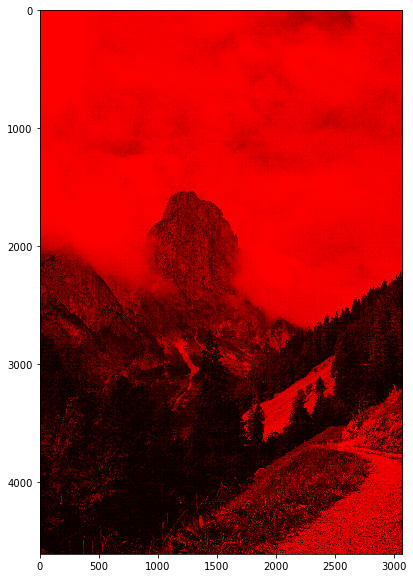

In [66]:
fix, ax = plt.subplots(figsize=(10,10))
ax.imshow(r_mat.astype(int),interpolation='nearest',cmap=plt.cm.gray);

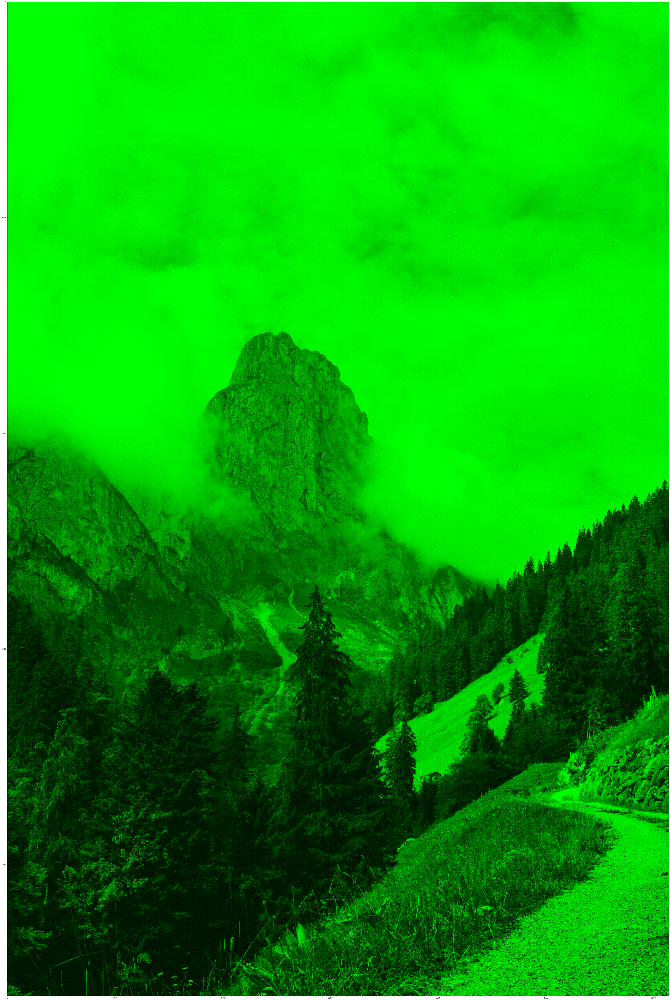

In [70]:
fix, ax = plt.subplots(figsize=(100,100))
ax.imshow(g_mat.astype(int),interpolation='nearest',cmap=plt.cm.gray);

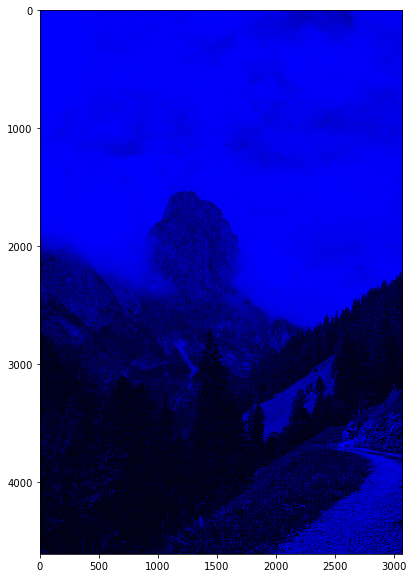

In [71]:
fix, ax = plt.subplots(figsize=(10,10))
ax.imshow(b_mat.astype(int),interpolation='nearest',cmap=plt.cm.gray);

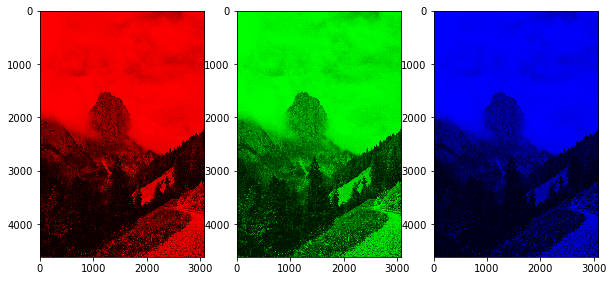

In [72]:
fig = plt.figure(figsize=(10,30))

plt.subplot(1, 3, 1)
plt.imshow(r_mat.astype(int),interpolation='nearest',cmap=plt.cm.gray);

plt.subplot(1, 3, 2)
plt.imshow(g_mat.astype(int),interpolation='nearest',cmap=plt.cm.gray);

plt.subplot(1, 3, 3)
plt.imshow(b_mat.astype(int),interpolation='nearest',cmap=plt.cm.gray);

#TODO Überschriften

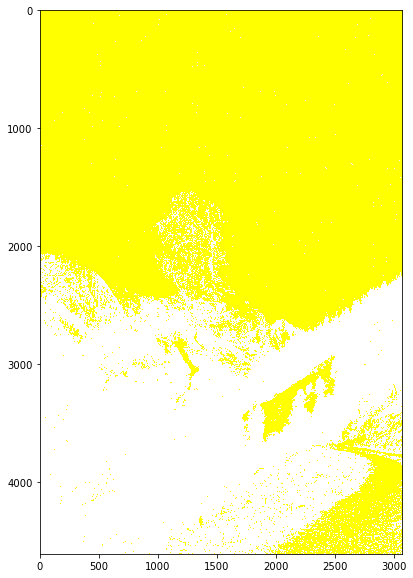

In [75]:
fix, ax = plt.subplots(figsize=(10,10))
ax.imshow(b_mat.astype('int8'),interpolation='nearest',cmap=plt.cm.gray);
#looks like complementary colours with int8, if so, why?

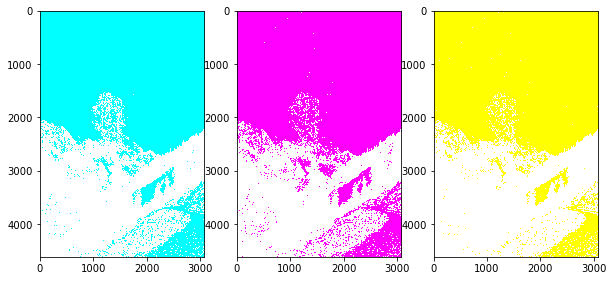

In [74]:
fig = plt.figure(figsize=(10,30))

plt.subplot(1, 3, 1)
plt.imshow(r_mat.astype('int8'),interpolation='nearest',cmap=plt.cm.gray);

plt.subplot(1, 3, 2)
plt.imshow(g_mat.astype('int8'),interpolation='nearest',cmap=plt.cm.gray);

plt.subplot(1, 3, 3)
plt.imshow(b_mat.astype('int8'),interpolation='nearest',cmap=plt.cm.gray);

In [76]:
invert_all=np.stack((r_inv,g_inv,b_inv), axis=2)
#takes some time

In [78]:
invert_all

array([[[255.        , 255.        , 255.        ],
        [255.        , 255.        , 255.        ],
        [255.        , 255.        , 255.        ],
        ...,
        [238.6328125 , 238.6328125 , 238.6328125 ],
        [235.16796875, 235.16796875, 235.16796875],
        [235.16796875, 235.16796875, 235.16796875]],

       [[255.        , 255.        , 255.        ],
        [255.        , 255.        , 255.        ],
        [255.        , 255.        , 255.        ],
        ...,
        [239.5078125 , 239.5078125 , 239.5078125 ],
        [234.85546875, 234.85546875, 234.85546875],
        [234.85546875, 234.85546875, 234.85546875]],

       [[255.        , 255.        , 255.        ],
        [255.        , 255.        , 255.        ],
        [255.        , 255.        , 255.        ],
        ...,
        [233.08203125, 233.08203125, 233.08203125],
        [239.41796875, 239.41796875, 239.41796875],
        [239.54296875, 239.54296875, 239.54296875]],

       ...,

      

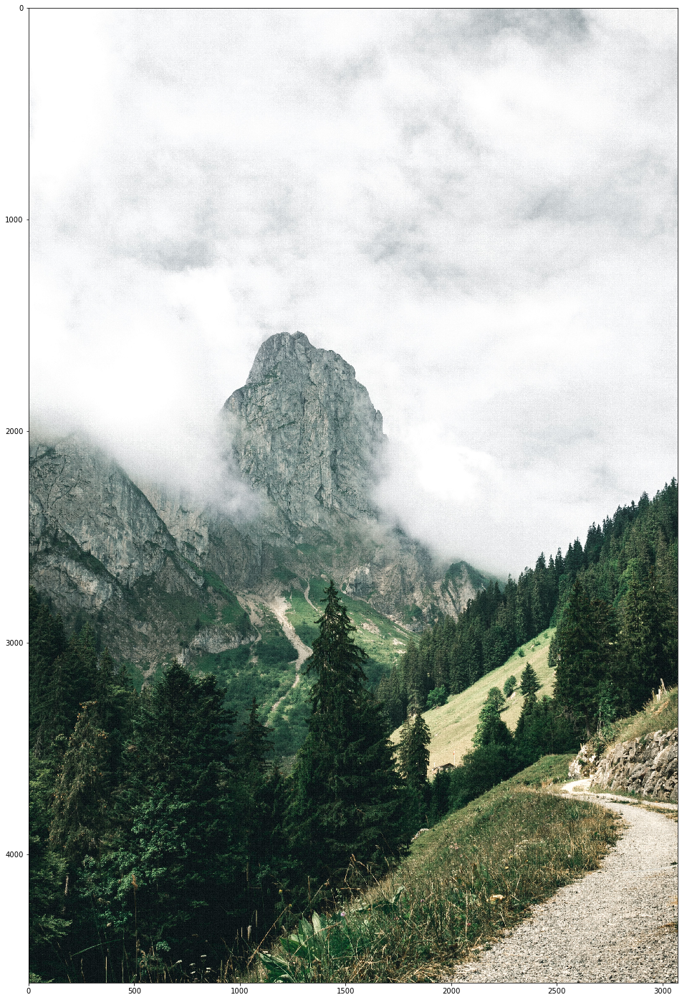

In [81]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype(int), interpolation="nearest",cmap=plt.cm.gray);
#plt.imshow(invert_all.astype(int), interpolation='nearest',cmap=plt.cm.gray);

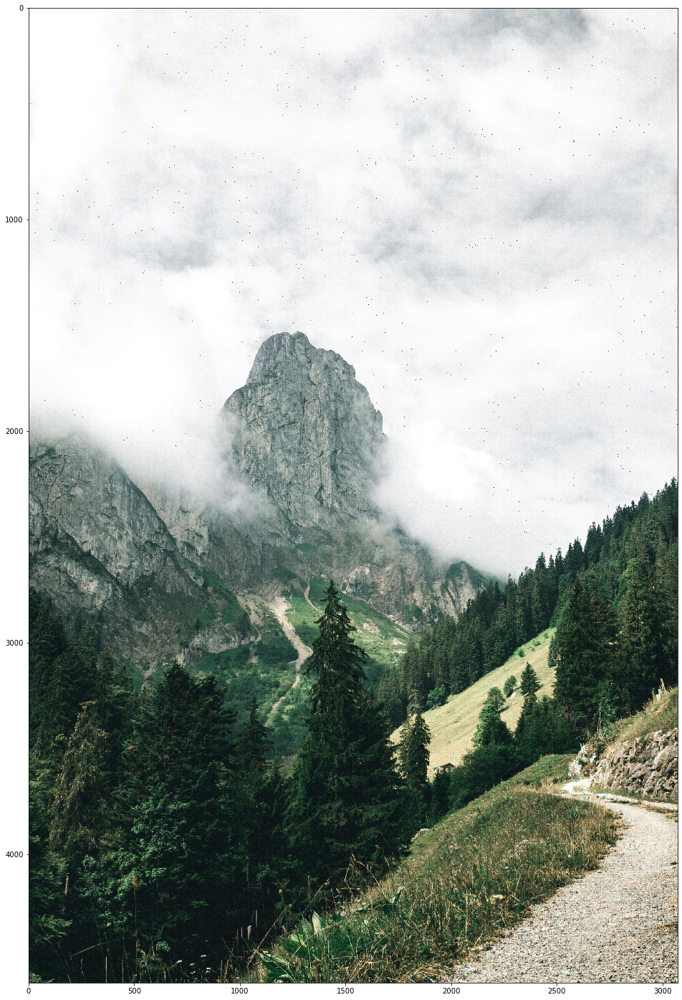

In [82]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype(np.uint8), interpolation="nearest",cmap=plt.cm.gray);

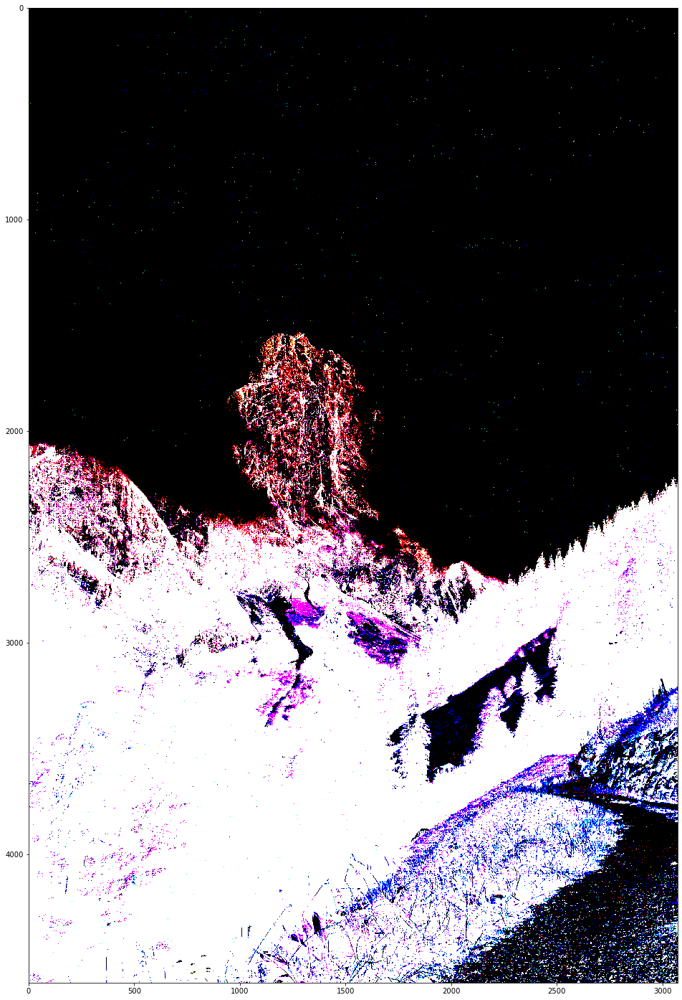

In [83]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype('int8'), interpolation="nearest",cmap=plt.cm.gray);

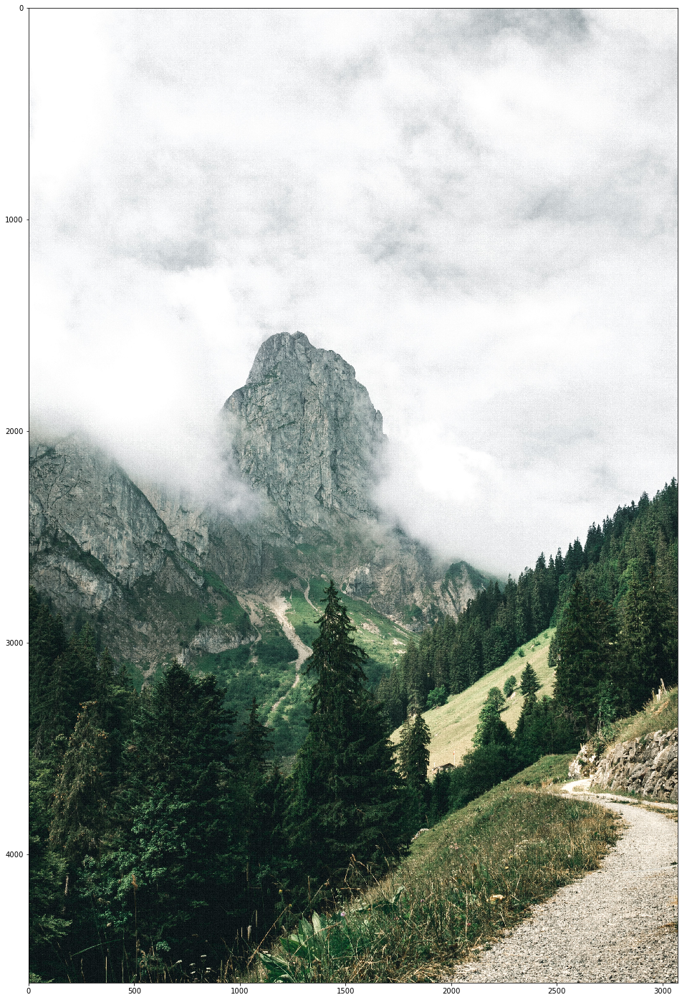

In [84]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype('int'), interpolation="nearest",cmap=plt.cm.gray);

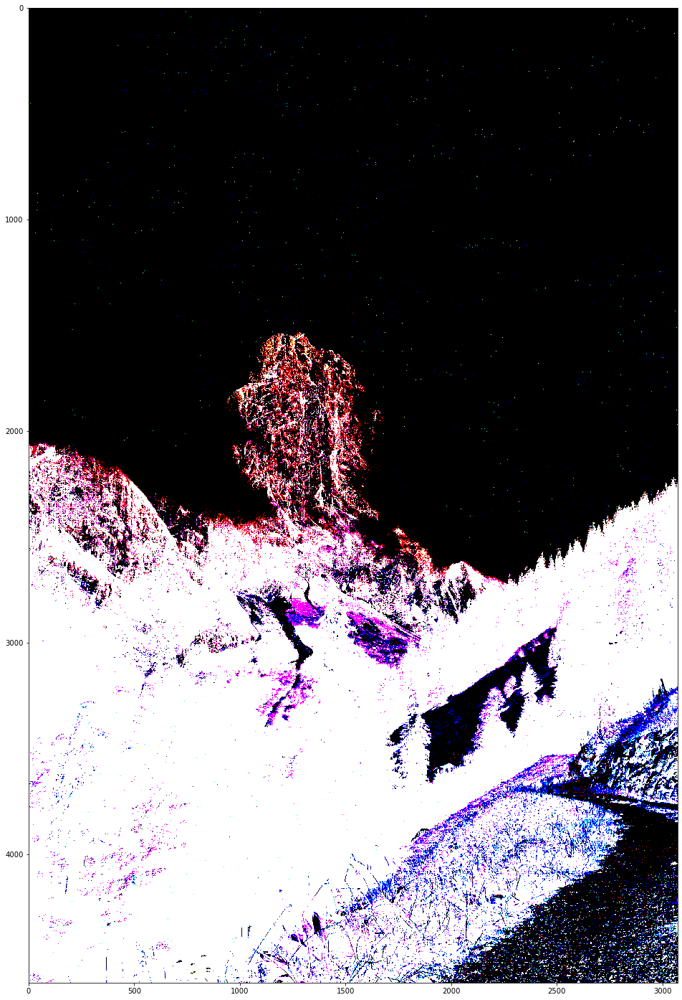

In [85]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype(np.int8), interpolation="nearest",cmap=plt.cm.gray);

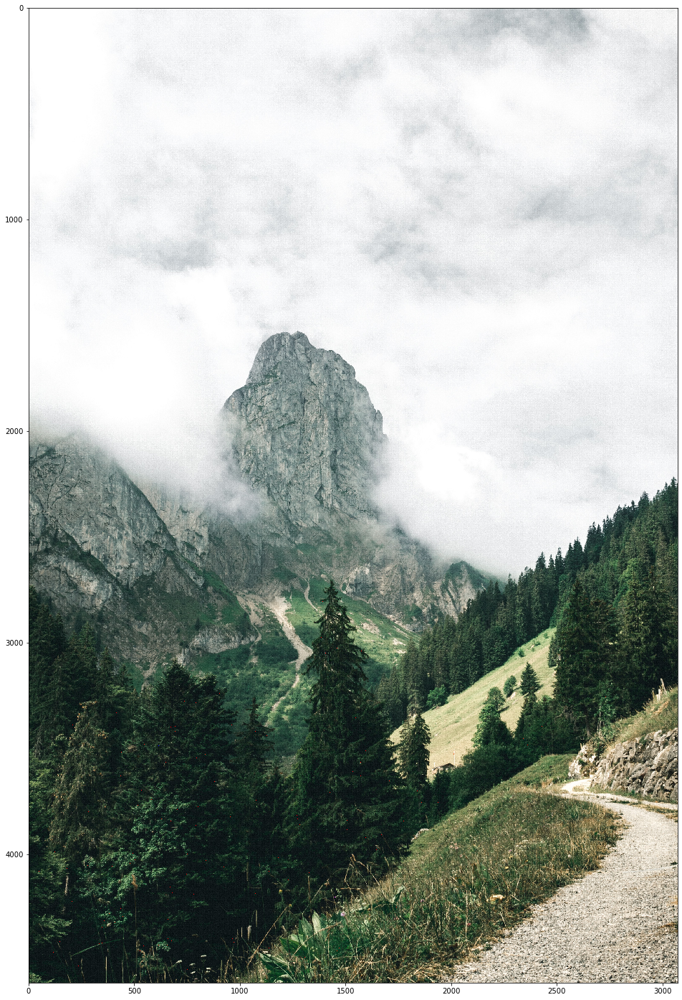

In [89]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype('uint'), interpolation="nearest",cmap=plt.cm.gray);

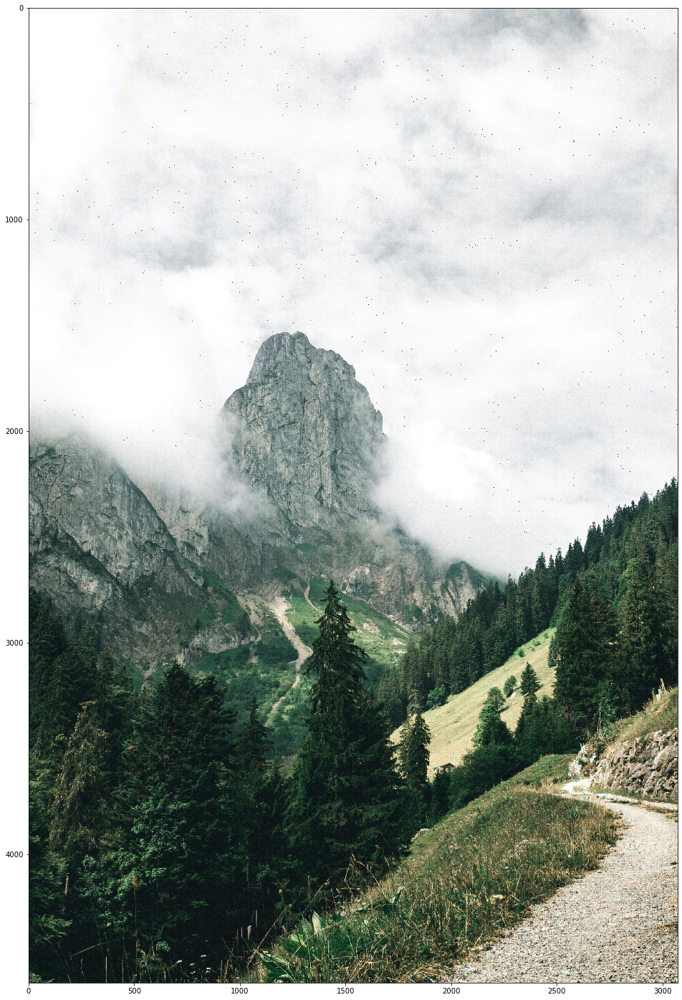

In [90]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype('uint8'), interpolation="nearest",cmap=plt.cm.gray);

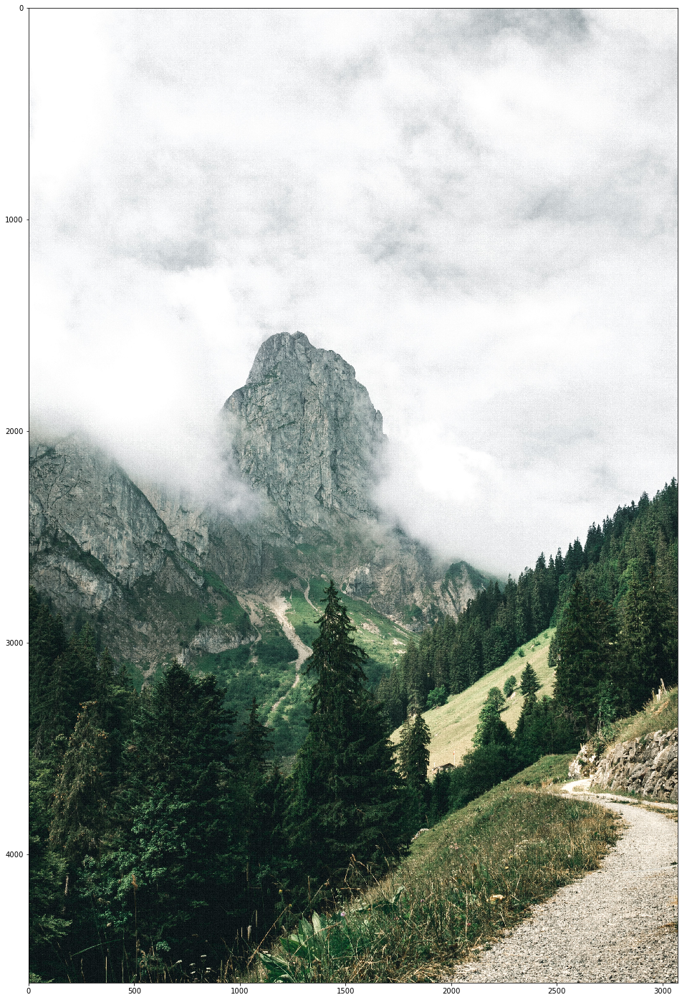

In [91]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype(np.int), interpolation="nearest",cmap=plt.cm.gray);

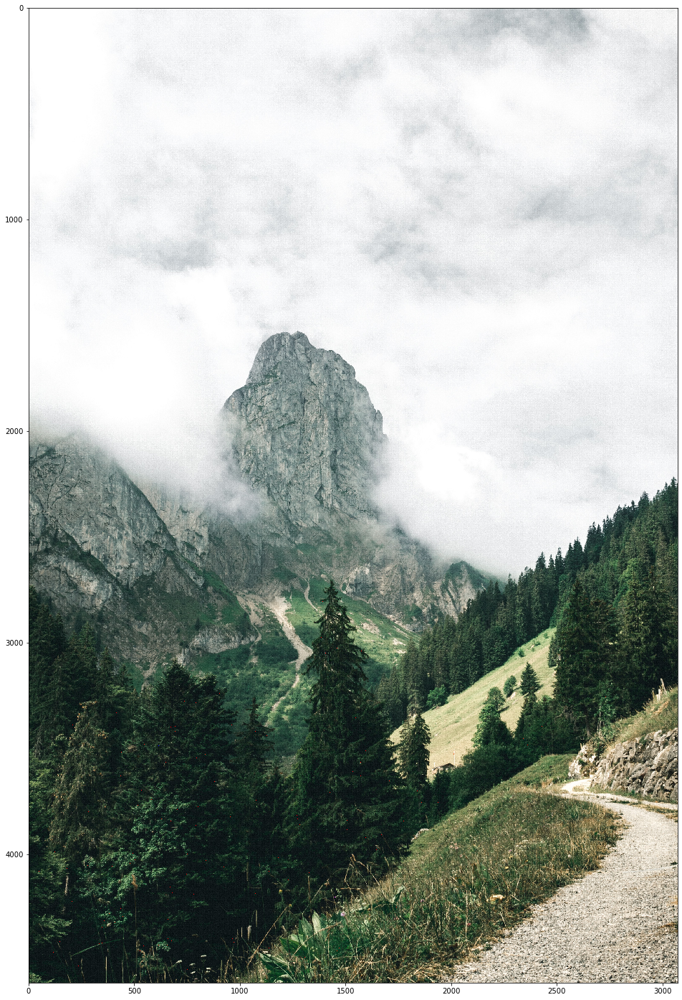

In [92]:
fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(invert_all.astype(np.uint), interpolation="nearest",cmap=plt.cm.gray);

In [ ]:
#sparse how und wenn es noch transfomrt ist?

In [ ]:
#welches ('')(u)int(8)('') zum darstellen verwenden und wo liegt DER Unterschied

In [ ]:
#alle 3 farben müssen 0  sein um 0 wet speichern zukönnne`?

In [250]:
#function schreiben in sparse matrix speichern und loss ausrechenen so wie bei vorherige und mit anderer matrix

measure compression by sparse oder eben wie vile MB, speichere als Sparse und lies dann aus 

In [ ]:
#as type utf 8 ' oder ohne'

In [ ]:
#norm

In [ ]:
#why still clipping input when it is only int?!?!?!?!?!?

#1,3 bei subplot

#safe as sarse matrices

#fix, ax = plt.subplots(figsize=(10,10))
#ax.imshow(r_inv,interpolation='nearest',cmap=plt.cm.gray);

#plt.imshow(forest,interpolation='nearest',cmap=plt.cm.gray); 

#fig, ax = plt.subplots(figsize=(10, 10))
#ax.imshow(forest,interpolation='nearest',cmap=plt.cm.gray);
#add back together to view and ggf safe und ratio

#alle 3 dann fct in r g b in ddan so do oder soo
#compress done auch plotten kanten geeignete bilder ratio
#was geht besser
#noise ka
#jpeg cosine
#versch inputs bei wavelet zb haar
#fcten k 1 big  r g b je und davor 1 2 3  und 1 big wo nur img name rein kommt?!

In [ ]:
#fct f r g b oder alles was 3 c und fct eine dafür und fct f alles workflow
#variate treshold
#wie viel % % eingeben oder trashold default und optional
#mode bei treshold
#bior 1,3 vs haar?!
#rate berechnen denoising
#compression rate, different arten wavelets haar idea dahinter mit dem zu null 
#more another function/bild itself load in another


In [ ]:
#automatize workflow
#fct entw einmal SW ound dann auf RGB anwenden oder so
#also dann fct die r , g , b gibt und davor drum eine fct die image gbit
#write functionS
#sparsity
#statt bior was anderes



#bior db2 oder haar und erklärung lgoischerweise
#bei dwt und idwt

#variate:interpolation='nearest',cmap=plt.cm.gray and is imshow THE Thin?

In [ ]:
#TODO Headline for pict zB bei 3 imshow r_inv, g_inv_b_inv

In [ ]:
#mehr fotos, function around wrappen

In [67]:
#WARNING:matplotlib.image:Clipp 
#ing input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). 
#why obwohl ich sie zu ints castete

In [ ]:
#anderes foto aucsh

In [ ]:
#fct k pio inv usw
#alo pic fct sparse bior haar usw 0.001 makes mehr nah an null und so oder so or mehr del

In [ ]:
#safe sparse matrix und unterschied

#compr rate denoise und zurück adden visualisiere wTraf